<a href="https://colab.research.google.com/github/hannari-python/tutorial/blob/master/family_budget/pyconTutorial_family_budget.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 家計調査データの分析

## データの処理

### 分析に用いるJupyter Notebook

https://github.com/hannari-python/tutorial/blob/master/family_budget/pyconTutorial_family_budget.ipynb

### データの紹介と閲覧

- [独立行政法人 統計センター 一般用ミクロデータ 平成21年全国消費実態調査 （十大費目）](https://github.com/hannari-python/tutorial/raw/master/data/ippan-microdata/ippan_2009zensho.zip) https://www.nstac.go.jp/services/ippan-microdata.html
- [独立行政法人 統計センター 一般用ミクロデータ 平成21年全国消費実態調査 （詳細品目）](https://github.com/hannari-python/tutorial/raw/master/data/ippan-microdata/ippan_2009zensho_s.zip) https://www.nstac.go.jp/services/ippan-microdata.html
- [独立行政法人 統計センター 一般用ミクロデータ 就業構造基本調査 （平成４年～24年）](https://github.com/hannari-python/tutorial/raw/master/data/ippan-microdata/ippan_shugyou.zip) https://www.nstac.go.jp/services/ippan-microdata.html

### 課題1

https://www.nstac.go.jp/services/ippan-microdata.html

をクリックし
- 一般用ミクロデータの利用規約に目を通しましょう。
- ippan_2009zensho.zip と ippan_2009zensho_s.zip がどのように異なるか? などデータの説明をざっと見てみましょう。

### データのGoogle Colabへの取得と解凍

次にGoogle Colabの環境内に一般用ミクロデータを取得してみましょう。
一般用ミクロデータの利用規約の「３　第三者への配布について」に、「第三者に一般用ミクロデータを配布する場合には、編集・加工されたデータではなく、当サイトからダウンロードしたフルセットデータで配布してください。」とあります。
これに従いフルセットデータをこのチュートリアルのGitHubのリポジトリにおさめてあります。

https://github.com/hannari-python/tutorial/tree/master/data/ippan-microdata

wgetというLinuxコマンドでGitHubのリポジトリ内のデータをGoogle Colabに取得してみましょう。

`!` の後にLinuxコマンドを書くとそのセルの命令はPythonプログラムではなくLinuxのコマンドとして実行されます。


In [1]:
!wget https://github.com/hannari-python/tutorial/raw/master/data/ippan-microdata/ippan_2009zensho_s.zip

--2020-08-27 18:43:27--  https://github.com/hannari-python/tutorial/raw/master/data/ippan-microdata/ippan_2009zensho_s.zip
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/hannari-python/tutorial/master/data/ippan-microdata/ippan_2009zensho_s.zip [following]
--2020-08-27 18:43:27--  https://raw.githubusercontent.com/hannari-python/tutorial/master/data/ippan-microdata/ippan_2009zensho_s.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 33090889 (32M) [application/zip]
Saving to: ‘ippan_2009zensho_s.zip’

ippan_2009zensho_s. 100%[===================>]  31.56M  48.4MB/s    in 0.7s    

2020-08-27 18:43

次に取得したzipファイルを解凍します。
unzip は zip ファイルを解凍する Linux コマンドです。

In [2]:
!unzip ippan_2009zensho_s.zip

Archive:  ippan_2009zensho_s.zip
  inflating: ippan_2009zensho_s/ippan_2009zensho_s.xls  
  inflating: ippan_2009zensho_s/ippan_2009zensho_s_dataset.csv  


### 課題2

- `ippan_2009zensho_s_dataset.csv` の何行目からが表データのスタートか見てみましょう。 `head` というLinuxコマンドがあります。 `head` コマンドのオプションは https://www.atmarkit.co.jp/ait/articles/1603/07/news023.html などを参照して活用してください。
- `ippan_2009zensho_s.xls` をGoogle Sheetsにインポートしてデータの定義を見てみましょう。
- データの内どの部分が必要なデータか考えてみましょう。

### 分析に必要なPythonパッケージのインストール

次に我々が用いるPythonパッケージのインストールを行います。

我々が用いる dash というパッケージはGoogle Colabに最初からインストールされてはいないのでこれをインストールします。またjupyter-dashというパッケージもインストールします。

dashはダッシュボードのWebアプリケーションを構築するためのフレームワークタイプのPythonパッケージです。
dashは基本的にJupyter Notebookでの使用が想定されたものではなかったのですが、jupyter-dashをインストールすることでJupyter Notebook上でdashを利用することが可能になります。

pip はPythonのパッケージをインストールするためのコマンドです。
空白を間にはさみ複数のパッケージを連続して書くとそれらがすべてインストールされます。

また plotly というパッケージをアップデートします。
Google Colabには最初からplotlyがインストールされていますが最新版を使うために下記では`--upgrade`オプションをつけインストールし直しています。

plotlyはオープンソースのインタラクティブなグラフライブラリのPythonパッケージです。


In [3]:
!pip install dash jupyter_dash
!pip install --upgrade plotly

     |████████████████████████████████| 71kB 2.4MB/s 
     |████████████████████████████████| 51kB 5.5MB/s 
     |████████████████████████████████| 1.2MB 19.3MB/s 
     |████████████████████████████████| 3.4MB 24.9MB/s 
     |████████████████████████████████| 194kB 43.1MB/s 
     |████████████████████████████████| 1.8MB 41.5MB/s 
     |████████████████████████████████| 358kB 37.9MB/s 
  Created wheel for dash: filename=dash-1.15.0-cp36-none-any.whl size=80892 sha256=c99a2d4c22fa1ce6c96867e9467d2f9384724d4fd14e1776608fee859237a9b7
  Stored in directory: /root/.cache/pip/wheels/d7/47/47/83e04669b545172324bae30853a71afe2962b733c568a229fe
  Created wheel for flask-compress: filename=Flask_Compress-1.5.0-cp36-none-any.whl size=5272 sha256=01337e837450c57fc4edad42d32e51a5aa27df82f7841bed3e65f8c2734f1a59
  Stored in directory: /root/.cache/pip/wheels/f7/e9/e4/5afc286be7c87461375e33152558415dfeb0c8f5af3b50e742
  Created wheel for dash-renderer: filename=dash_renderer-1.7.0-cp36-none-any.whl si

### pandas を用いたデータの読み込み

次に pandas を用いてデータの読み込みを行います。
pandasはGoogle Colabに最初からインストールされているのでpip installを行う必要はありません。
pandasはテーブル形式のデータを簡単かつ直感的に操作できるように「データフレーム」というデータ構造を提供してくれるPythonパッケージです。

下記では `df` がその「データフレーム」になります。

In [4]:
import pandas as pd

In [5]:
df = pd.read_csv('ippan_2009zensho_s/ippan_2009zensho_s_dataset.csv', encoding='shift_jis', header=8)

### 課題3
- `encoding` オプションを付けないと`df`がどうなるか確認しましょう
- `header` オプションを付けないと`df`がどうなるか確認しましょう
- `header` オプションの数値を変えると`df`がどうなるか確認しましょう
- `skiprows` というオプションの効果も試してみましょう

### データフレームとは

データフレームとはとりあえずテーブルデータを保持するためのデータ構造と考えていただけばOKです。
`df`とだけ書いたセルをそのまま実行するとデータの内容を見ることができます。
出力結果の最後の行には
`45811 rows × 430 columns`と書かれていることがわかります。

In [6]:
df

,3City,T_SeJinin,T_SyuJinin,T_JuSyoyu,T_Syuhi,T_Age_5s,T_Age_65,Weight,Y_Income,L_Expenditure,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure,E001,E002,E003,E004,E005,E006,E007,E008,E009,E010,E011,E012,E013,E014,E015,E016,E017,E018,E019,E020,...,E371,E372,E373,E374,E375,E376,E377,E378,E379,E380,E381,E382,E383,E384,E385,E386,E387,E388,E389,E390,E391,E392,E393,E394,E395,E396,E397,E398,E399,E400,E401,E402,E403,E404,E405,E406,E407,E408,E409,E410
0,1,2,1,1,1,1,1,895.266667,3917,201649,47756,16028,9652,6702,8088,726,21546,0,14433,76719,47756,4574,1728,1557,1027,262,3450,2070,555,393,432,3722,2882,785,1286,621,64,126,840,636,...,1320,2186,6448,138,512,535,582,277,4404,2885,65,939,1089,224,538,31,2240,18347,1185,57,5425,244,284,9490,231,95,182,1154,17820,15248,2572,24149,19000,5149,417,3591,1141,576,186,390
1,1,2,1,1,1,1,1,895.266667,6675,166381,34054,7416,26313,17062,6989,7637,20773,0,19048,27089,34054,2813,1019,1050,489,254,1863,905,564,132,261,2432,2112,632,621,697,23,139,320,203,...,231,668,1677,21,258,100,78,38,1182,1581,26,899,189,161,291,14,656,5794,229,10,3980,49,96,804,96,32,95,404,7335,6811,523,8710,7687,1023,239,437,348,282,94,188
2,1,2,1,1,1,1,1,895.266667,6706,259736,84501,1927,10082,6741,5090,11015,53372,0,17289,69719,84501,5004,657,1122,3067,158,7010,4216,718,836,1239,7742,5284,3382,1136,628,43,95,2458,2248,...,4942,3637,8037,190,1210,1606,423,557,4050,8032,124,3204,3350,316,1007,30,1096,20994,1447,40,4398,497,258,9418,295,75,121,4445,9115,8095,1021,11933,7405,4529,1166,2705,658,429,183,246
3,1,2,1,1,1,1,1,895.266667,2790,114511,41664,730,22358,5413,1205,5049,17411,0,8605,12077,41664,4372,1785,1474,910,202,3680,2713,363,255,349,3093,2512,925,828,565,45,149,581,383,...,306,113,2073,36,116,202,109,56,1554,487,18,116,147,45,146,14,182,1661,45,3,157,349,63,667,34,6,24,314,2692,2291,401,4136,2644,1492,69,977,445,205,55,151
4,1,2,1,1,1,1,1,895.266667,2577,193505,56981,3779,28747,4812,4243,751,16435,0,38231,39527,56981,4957,1463,1463,1763,268,4712,3181,558,413,560,4644,3726,1310,1682,518,87,129,919,637,...,842,699,7654,46,160,131,612,93,6613,1780,7,643,870,170,82,8,1116,4768,280,22,2000,164,50,1347,17,96,133,660,5131,3859,1272,16907,4840,12068,699,10940,428,445,138,307
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45806,0,3,2,2,2,0,2,552.266667,4398,216774,46169,39809,32508,2896,4203,18778,21739,30,4315,46326,46169,5207,2668,1391,913,235,4929,3086,810,515,518,3851,3055,1001,1263,607,64,119,797,604,...,1022,1163,3508,82,243,280,362,165,2376,1196,40,576,276,67,193,45,1122,12331,1560,291,728,1149,292,6481,243,48,904,634,10563,7368,3194,12858,10883,1975,175,1076,724,1817,957,860
45807,0,3,2,2,2,0,2,552.266667,4844,165978,52670,37839,25403,3532,2293,7016,5022,8,12656,19540,52670,5932,3008,1602,1051,271,5653,3556,927,578,593,4410,3527,1164,1477,680,71,134,883,669,...,408,335,1003,43,200,128,150,76,406,527,19,231,172,20,68,16,516,3927,727,82,125,888,81,1493,115,18,191,208,6634,5082,1552,5104,4120,984,89,523,372,769,363,406
45808,0,3,2,2,2,0,2,552.266667,4630,244064,53784,76871,18196,17747,3308,13499,27705,25,4309,28619,53784,6033,3086,1614,1052,280,5761,3633,932,596,599,4503,3581,1184,1485,700,75,138,922,707,...,626,757,2547,41,121,227,423,104,1630,936,26,282,295,38,266,29,402,6524,847,117,300,812,186,3022,187,38,608,408,6198,3433,2765,8804,7553,1251,190,699,362,1431,973,457
45809,0,3,2,2,2,0,2,552.266667,6738,399003,123080,38810,19711,2816,5666,21831,23914,28,58844,104302,123080,13423,6772,3770,2247,634,13315,8362,2196,1353,1405,10379,8271,2713,3424,1644,174,316,2108,1603,...,2179,2480,7502,198,515,597,772,353,5066,2641,85,1228,606,119,508,95,2025,26762,3328,817,1364,3160,624,13367,517,102,1928,1554,27466,16321,11145

### データフレームの列の選択

430列(変数)ある列から、細かい分類の支出情報の列などを取り除いてみましょう。
`df` のうち `Food`から`OL_Expenditure`までの列を選択し、支出費目の内大きな分類の列だけにしてみましょう。
そのためにはデータフレームの `loc` メソッドを使います。

In [7]:
exp10 = df.loc[:, 'Food':'OL_Expenditure']
exp10

,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
0,47756,16028,9652,6702,8088,726,21546,0,14433,76719
1,34054,7416,26313,17062,6989,7637,20773,0,19048,27089
2,84501,1927,10082,6741,5090,11015,53372,0,17289,69719
3,41664,730,22358,5413,1205,5049,17411,0,8605,12077
4,56981,3779,28747,4812,4243,751,16435,0,38231,39527
...,...,...,...,...,...,...,...,...,...,...
45806,46169,39809,32508,2896,4203,18778,21739,30,4315,46326
45807,52670,37839,25403,3532,2293,7016,5022,8,12656,19540
45808,53784,76871,18196,17747,3308,13499,27705,25,4309,28619
45809,123080,38810,19711,2816,5666,21831,23914,28,58844,104302


### [記述統計量(英: descriptive statistics value)](https://ja.wikipedia.org/wiki/%E8%A6%81%E7%B4%84%E7%B5%B1%E8%A8%88%E9%87%8F) の確認

次にデータフレームの列をフィルタした後は各列のデータの平均値などを見てみましょう。そのような値は記述統計量と呼ばれます。
そのためにはデータフレームの `describe` メソッドを使います。
記述統計量は英語でdescriptive statistics valueなのでメソッド名がdescribeになるわけです。

### 課題4
- describeの結果の行名が何を示すか https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.describe.html を見て確認しましょう

In [8]:
exp10.describe()

,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
count,45811.000000,4.581100e+04,45811.000000,45811.000000,45811.000000,45811.000000,4.581100e+04,4.581100e+04,4.581100e+04,4.581100e+04
mean,68740.210364,1.612791e+04,19420.995569,9373.956342,12054.818668,13280.968850,4.469237e+04,1.501489e+04,3.109929e+04,6.856828e+04
std,29209.813101,3.878798e+04,8246.369457,12941.144209,15069.659817,18928.182013,7.738839e+04,4.417047e+04,3.289503e+04,8.456648e+04
min,9737.000000,0.000000e+00,1632.000000,27.000000,64.000000,45.000000,7.800000e+01,0.000000e+00,3.720000e+02,3.450000e+02
25%,48104.500000,6.590000e+02,13589.500000,2877.500000,3893.500000,3849.000000,1.037250e+04,0.000000e+00,1.218200e+04,2.479300e+04
50%,63498.000000,2.877000e+03,17905.000000,5614.000000,7686.000000,7687.000000,2.346500e+04,1.761000e+03,2.170800e+04,4.463400e+04
75%,83502.000000,1.746200e+04,23544.500000,11058.000000,14515.500000,15434.500000,4.876050e+04,1.353500e+04,3.831100e+04,8.090950e+04
max,394347.000000,1.702352e+06,128725.000000,584980.000000,569141.000000,715039.000000,2.306300e+06,2.711758e+06,1.019545e+06,2.133987e+06


代表値はわかりましたがこれだけではデータをちゃんと「見る」ことができていません。
以下から本格的に「データの可視化」を行っていきましょう。

## データの可視化とダッシュボードの作成

以降ではデータの可視化とダッシュボードの作成を行う方法をお伝えします。

### 支出費目毎の金額の分布の比較
まず支出費目毎 (`Food`列から`OL_Expenditure`列) の金額の分布(どの程度の金額を使っている人が何人いるか)を見てみましょう。

これを手っ取り早く行うには[joypy](https://github.com/sbebo/joypy)というパッケージが便利です。
ということでjoypy を pip でインストールしましょう。

In [9]:
!pip install joypy

joypyで前述の分布を見るには下記を実行します。
オプションにx軸のレンジ(x_range)と図のサイズ(figsize)を指定しています。


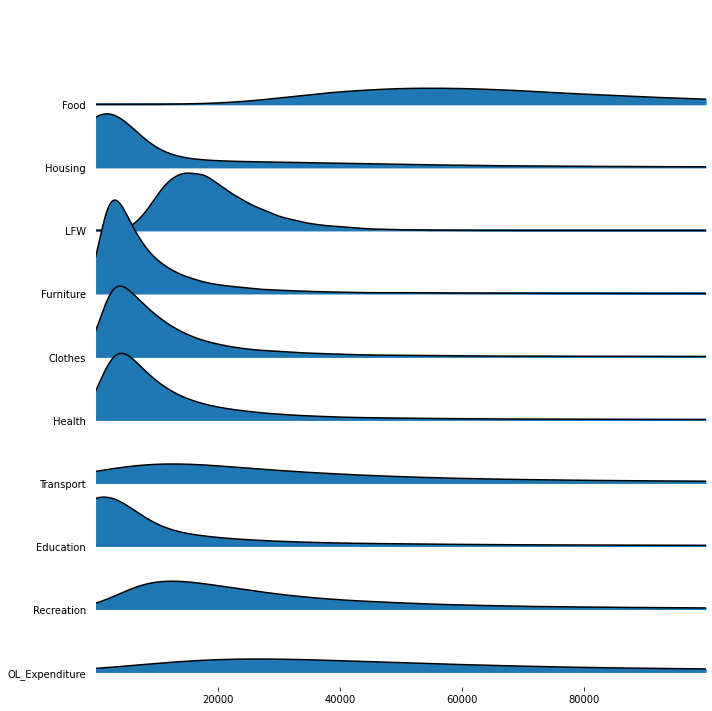

In [11]:
import joypy
import pandas as pd

fig, axes = joypy.joyplot(exp10, x_range=[0, 100000], figsize=(10,10))

### 課題5
- exp10 の列のデータとjoypyが作る図の関係を考えてみましょう。
- x_rangeの上限の100000はこれまでの何を参考に設定したでしょうか?
- どういう支出費目にどういう特徴があるか言語化してみましょう。

### ある支出費目の金額のインタラクティブなヒストグラムを作る

joypyは全体像を見るのには役立ちますが、かなり大まかです。
静的画像なのでズームインして詳しく見るといったこともできません。
そこでplotlyを使ってインタラクティブなヒストグラムを作ってみましょう。
下記のセルでそれが作れます。
`px.histogram()`のオプション`x`はデータフレーム`exp10`のどの列のデータを使ってヒストグラムを書くかを指定するものになります。

In [12]:
import plotly.express as px
fig = px.histogram(exp10, x="Food")
fig.show()

次に`x`に`Food`とは別の費目`Housing`を指定してみます。


In [13]:
fig = px.histogram(exp10, x="Housing")
fig.show()

費目`Food`とは異なり0円のところに山があります。
また金額の最大値が大きいため(そして金額の全範囲を表示しているため)、count数(xの額を使っている人の数)が多いところが詳しく表示できてきません。

### 課題6
- plotlyのズームイン機能を使って前述の箇所を詳しく見てみましょう。


## ヒストグラムで見る支出費目の変更をGUIで行うためにダッシュボードを作る

先程、2つ費目`Food`と`Housing`のヒストグラムを作る際に変更を行ったのは、`px.histogram()`のオプション`x`の値だけでした。
その値を毎回手で書くのは面倒です。
そこで費目をドロップダウンリストなりでGUIで選択し、動的に表示されるヒストグラムの内容が変わると便利です。
このような何からのコントロールのためのコンポーネントやそのコントロールに応じた可視化コンポーネントなどが一つの画面にまとめられたものは「ダッシュボード」と呼ばれています。
以降ではそのダッシュボードをステップ・バイ・ステップで作っていきます。

下記がそれを行うセルです。
少し長いですが
`app.layout = html.Div(`
より前の行はおまじないなので気にする必要はありません。
重要なのは「`app.layout`にダッシュボードのコンポーネントを入れていく」
ことだけです。

In [14]:
from jupyter_dash import JupyterDash
import dash
import dash_core_components as dcc
import dash_html_components as html
import pandas as pd

external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']
app = JupyterDash(__name__, external_stylesheets=external_stylesheets)
server = app.server

fig = px.histogram(exp10, x="Food")

app.layout = html.Div(
    dcc.Graph(
        id='kakei-hist',
        figure=fig
    )
)


In [15]:
app.run_server(mode="inline")

<IPython.core.display.Javascript object>

上記でとりあえずヒストグラムを表示することができました。
ですがこれではただのヒストグラムでこれまでと変わりがありません。
次にヒストグラムの下の方に費目のドロップダウンリストを追加してみましょう。

In [18]:
external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']
app = JupyterDash(__name__, external_stylesheets=external_stylesheets)
server = app.server

fig = px.histogram(exp10, x="Food")

app.layout = html.Div([
    dcc.Graph(
        id='kakei-hist',
        figure=fig
    ),
    dcc.Dropdown(
        id='kakei-dropdown',
        options=[
            {'label': 'Food', 'value': 'Food'},
            {'label': 'Housing', 'value': 'Housing'},
            {'label': 'LFW', 'value': 'LFW'}
        ],
        value='Food'
    )
])

In [19]:
app.run_server(mode="inline")

<IPython.core.display.Javascript object>

In [ ]:
external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']
app = JupyterDash(__name__, external_stylesheets=external_stylesheets)
server = app.server

app.layout = html.Div([
    dcc.Dropdown(
        id='kakei-dropdown',
        options=[
            {'label': 'Food', 'value': 'Food'},
            {'label': 'Housing', 'value': 'Housing'},
            {'label': 'LFW', 'value': 'LFW'}
        ],
        value='Food'
    ),
    html.Div(id='dd-output-container')
])

@app.callback(
    dash.dependencies.Output('dd-output-container', 'children'),
    [dash.dependencies.Input('kakei-dropdown', 'value')])
def update_output(value):
    return 'You have selected "{}"'.format(value)

In [ ]:
app.run_server(mode="inline")

<IPython.core.display.Javascript object>

In [ ]:
external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']
app = JupyterDash(__name__, external_stylesheets=external_stylesheets)
server = app.server

fig = px.histogram(data, x="Food")

app.layout = html.Div([
    dcc.Graph(
        id='kakei-hist',
        figure=fig
    ),
    dcc.Dropdown(
        id='kakei-dropdown',
        options=[
            {'label': 'Food', 'value': 'Food'},
            {'label': 'Housing', 'value': 'Housing'},
            {'label': 'LFW', 'value': 'LFW'}
        ],
        value='Food'
    )
])

@app.callback(
    dash.dependencies.Output('kakei-hist', 'figure'),
    [dash.dependencies.Input('kakei-dropdown', 'value')])
def update_output(value):
    return px.histogram(data, x=value)

In [ ]:
app.run_server(mode="inline")

<IPython.core.display.Javascript object>

## 一つのビューで複数のヒストグラムを見る

In [ ]:
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Histogram(x=data['Food'], name='Food'))
fig.add_trace(go.Histogram(x=data['LFW'], name='LFW'))

fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.75)
fig.show()

## ヒストグラムの系列の追加をダッシュボードで行う

In [ ]:
external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']
app = JupyterDash(__name__, external_stylesheets=external_stylesheets)
server = app.server

fig = px.histogram(data, x="Food")

app.layout = html.Div([
    dcc.Graph(
        id='kakei-hist',
        figure=fig
    ),
    dcc.Dropdown(
        id='kakei-dropdown',
        options=[
            {'label': 'Food', 'value': 'Food'},
            {'label': 'Housing', 'value': 'Housing'},
            {'label': 'LFW', 'value': 'LFW'}
        ],
        value=['Food', 'LFW'],
        multi=True
    )
])

@app.callback(
    dash.dependencies.Output('kakei-hist', 'figure'),
    [dash.dependencies.Input('kakei-dropdown', 'value')])
def update_output(value):
    fig = go.Figure()
    for i in value:
        fig.add_trace(go.Histogram(x=data[i], name=i))
    fig.update_layout(barmode='overlay')
    fig.update_traces(opacity=0.75)
    return fig


## 人の項目カテゴリ毎の支出カテゴリの分布の違いを見る

In [ ]:
all = s.loc[:, :'OL_Expenditure']
city = all.drop(all.columns[1:10], axis=1)

In [ ]:
city

,3City,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
0,1,47756,16028,9652,6702,8088,726,21546,0,14433,76719
1,1,34054,7416,26313,17062,6989,7637,20773,0,19048,27089
2,1,84501,1927,10082,6741,5090,11015,53372,0,17289,69719
3,1,41664,730,22358,5413,1205,5049,17411,0,8605,12077
4,1,56981,3779,28747,4812,4243,751,16435,0,38231,39527
...,...,...,...,...,...,...,...,...,...,...,...
45806,0,46169,39809,32508,2896,4203,18778,21739,30,4315,46326
45807,0,52670,37839,25403,3532,2293,7016,5022,8,12656,19540
45808,0,53784,76871,18196,17747,3308,13499,27705,25,4309,28619
45809,0,123080,38810,19711,2816,5666,21831,23914,28,58844,104302


In [ ]:
city['3City'] = city['3City'].replace([1, 0], ["3City", "other"])

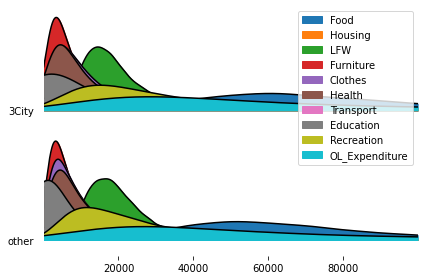

In [ ]:
import joypy
fig, axes = joypy.joyplot(city, by="3City", x_range=[0, 100000], legend=True)

In [ ]:
city3 = city[city["3City"]=="3City"]

In [ ]:
city3

,3City,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
0,3City,47756,16028,9652,6702,8088,726,21546,0,14433,76719
1,3City,34054,7416,26313,17062,6989,7637,20773,0,19048,27089
2,3City,84501,1927,10082,6741,5090,11015,53372,0,17289,69719
3,3City,41664,730,22358,5413,1205,5049,17411,0,8605,12077
4,3City,56981,3779,28747,4812,4243,751,16435,0,38231,39527
...,...,...,...,...,...,...,...,...,...,...,...
18345,3City,61774,26527,14664,1823,4840,7787,1830,0,4331,7311
18346,3City,92222,72412,74346,3670,4345,13058,33555,0,14751,78634
18347,3City,47394,52022,25936,5384,2998,32654,13168,0,25325,1954
18348,3City,85804,23771,51421,9171,1660,2672,15981,0,19116,40749


In [ ]:
city_other = city[city["3City"]=="other"]

In [ ]:
city_other

,3City,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
18350,other,33007,221,13532,13996,4116,12309,49244,0,23609,505730
18351,other,29133,589,18349,3624,7726,863,45271,0,28709,99614
18352,other,49758,640,11491,9522,2911,1133,53521,0,12573,17443
18353,other,45726,4168,8767,9317,4763,2377,28040,0,41300,567909
18354,other,105865,303,16267,22594,11302,10494,43257,0,113424,1515968
...,...,...,...,...,...,...,...,...,...,...,...
45806,other,46169,39809,32508,2896,4203,18778,21739,30,4315,46326
45807,other,52670,37839,25403,3532,2293,7016,5022,8,12656,19540
45808,other,53784,76871,18196,17747,3308,13499,27705,25,4309,28619
45809,other,123080,38810,19711,2816,5666,21831,23914,28,58844,104302


In [ ]:
import plotly.graph_objects as go

fig = go.Figure(go.Histogram(
    x=city3["Food"],
    bingroup=5000))

fig.add_trace(go.Histogram(
    x=city_other["Food"],
    bingroup=5000))

fig.update_layout(
    barmode="overlay",
    bargap=0.1)

fig.update_traces(opacity=0.75)
fig.show()

# 以下から吉岡さんによる「機械学習」パート

## ニクラス分類

家計の情報から三大都市圏に住んでいるかどうかを予測する問題を考えます。

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import plot_confusion_matrix

### 前処理

#### 目的変数と説明変数の取得

In [ ]:
y = s["3City"].values
print(type(y), y.shape)
print(np.unique(y))

<class 'numpy.ndarray'> (45811,)
[0 1]


三大都市圏のサンプル数の比率は40%です。今はニクラス分類問題を考えているので、ランダムに予測をしても40%の確率で正解します。

In [ ]:
np.sum(y == 1) / len(y)

0.4005588177511951

説明変数として収入と支出を

In [ ]:
X = s.loc[:, "Y_Income":"OL_Expenditure"]
type(X), X.shape

(pandas.core.frame.DataFrame, (45811, 12))

#### データを訓練用とテスト用に分割

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

### 予測モデルの訓練と評価

* Linear SVM
  * Y_Incomeを説明変数とする


#### 線形SVM

In [ ]:
clf = LinearSVC()
clf.fit(X_train.to_numpy(), y_train)

/usr/local/lib/python3.6/dist-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=1000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)

In [ ]:
clf.score(X_train.to_numpy(), y_train)

0.4239728928420161

In [ ]:
clf.score(X_test.to_numpy(), y_test)

0.42783436962561183

#### 非線形SVM（ガウスカーネル）

線形SVMと比べて少し時間がかかります。

In [ ]:
clf = SVC()
clf.fit(X_train.to_numpy(), y_train)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

In [ ]:
print("Score (train): {}".format(clf.score(X_train.to_numpy(), y_train)))
print("Score (test): {}".format(clf.score(X_test.to_numpy(), y_test)))

Score (train): 0.6255497996285798
Score (test): 0.6158883450191824


In [ ]:
print(clf.score(X_test.to_numpy(), y_test))

0.6158883450191824


##### ハイパーパラメータ

* C: float, default=1.0 
  * Regularization parameter. The strength of the regularization is inversely proportional to C. Must be strictly positive. The penalty is a squared l2 penalty.
* kernel{‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’, ‘precomputed’}, default=’rbf’
  * Specifies the kernel type to be used in the algorithm. It must be one of ‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’, ‘precomputed’ or a callable. If none is given, ‘rbf’ will be used. If a callable is given it is used to pre-compute the kernel matrix from data matrices; that matrix should be an array of shape (n_samples, n_samples).


In [ ]:
clf = SVC(C=0.1)
clf.fit(X_train.to_numpy(), y_train)
print("Score (train): {}".format(clf.score(X_train.to_numpy(), y_train)))
print("Score (test): {}".format(clf.score(X_test.to_numpy(), y_test)))

Score (train): 0.6187730101326036
Score (test): 0.6111258102923667


In [ ]:
clf = SVC(C=10.0)
clf.fit(X_train.to_numpy(), y_train)
print("Score (train): {}".format(clf.score(X_train.to_numpy(), y_train)))
print("Score (test): {}".format(clf.score(X_test.to_numpy(), y_test)))

Score (train): 0.6340859479360115
Score (test): 0.6208493186929488


### ランダムフォレスト

In [ ]:
clf = RandomForestClassifier()
clf.fit(X_train.to_numpy(), y_train)
print("Score (train): {}".format(clf.score(X_train.to_numpy(), y_train)))
print("Score (test): {}".format(clf.score(X_test.to_numpy(), y_test)))

Score (train): 1.0
Score (test): 0.6336817039290912


### 勾配ブースティング

In [ ]:
clf = GradientBoostingClassifier()
clf.fit(X_train.to_numpy(), y_train)
print("Score (train): {}".format(clf.score(X_train.to_numpy(), y_train)))
print("Score (test): {}".format(clf.score(X_test.to_numpy(), y_test)))

Score (train): 0.6660476330107842
Score (test): 0.6434713586453235


### スケーリング

In [ ]:
scaler = preprocessing.StandardScaler().fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [ ]:
clf = GradientBoostingClassifier()
clf.fit(X_train_scaled, y_train)
print("Score (train): {}".format(clf.score(X_train_scaled, y_train)))
print("Score (test): {}".format(clf.score(X_test_scaled, y_test)))

Score (train): 0.6660476330107842
Score (test): 0.6434713586453235


## 多クラス分類

### 前処理

#### 目的変数の取得

In [ ]:
y = s["T_Age_5s"].values
print(type(y), y.shape)
print(np.unique(y))

<class 'numpy.ndarray'> (45811,)
[0 1 2 3 4 5 6 7 8 9]


各クラスのサンプル数を確認します。

In [ ]:
np.histogram(y, bins=np.arange(10))

(array([11466,  1068,  2602,  4008,  4209,  4168,  4523,  5156,  8611]),
 array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]))

比率に直すと次のようになります。

In [ ]:
np.set_printoptions(precision=3)
np.histogram(y, bins=np.arange(10))[0] / len(y)

array([0.25 , 0.023, 0.057, 0.087, 0.092, 0.091, 0.099, 0.113, 0.188])

#### データを訓練用とテスト用に分割

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

### 予測モデルの訓練と評価

#### 勾配ブースティング

In [ ]:
clf = GradientBoostingClassifier()
clf.fit(X_train.to_numpy(), y_train)
print("Score (train): {}".format(clf.score(X_train.to_numpy(), y_train)))
print("Score (test): {}".format(clf.score(X_test.to_numpy(), y_test)))

Score (train): 0.47027009415827714
Score (test): 0.3987299907395158


#### 混同行列

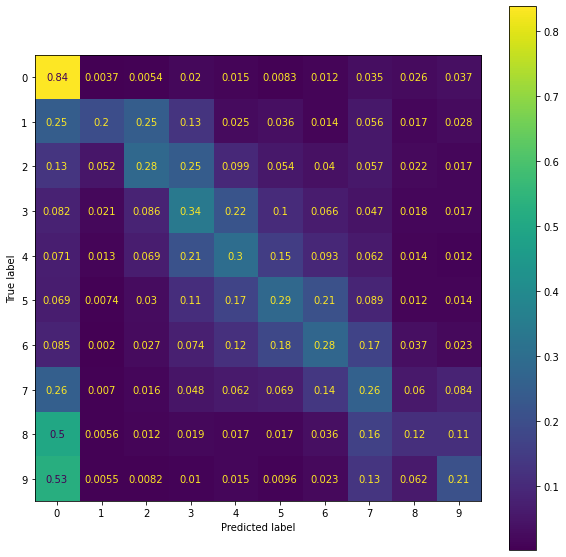

In [ ]:
fig = plt.figure(figsize=(10, 10))
disp = plot_confusion_matrix(clf, X_test.to_numpy(), y_test,
                                #  display_labels=class_names,
                                #  cmap=plt.cm.Blues)
                                normalize="true", ax=plt.gca())
plt.show()

#### サンプルバランス補正

In [ ]:
clf = SVC(C=10.0, class_weight="balanced")
clf.fit(X_train.to_numpy(), y_train)
print("Score (train): {}".format(clf.score(X_train.to_numpy(), y_train)))
print("Score (test): {}".format(clf.score(X_test.to_numpy(), y_test)))

Score (train): 0.3474733652624377
Score (test): 0.3270935308903294


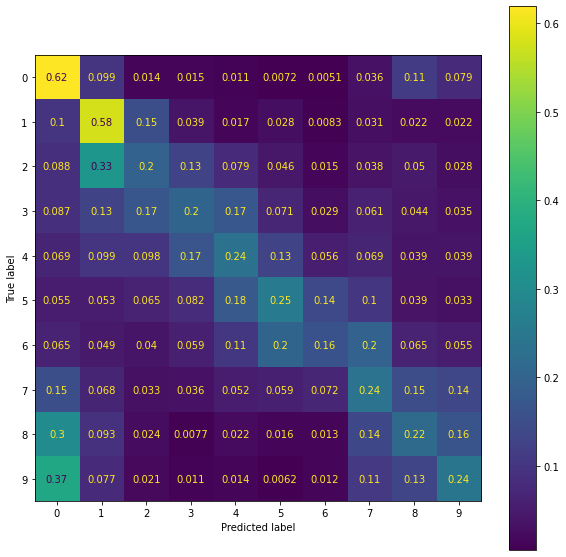

In [ ]:
fig = plt.figure(figsize=(10, 10))
disp = plot_confusion_matrix(clf, X_test.to_numpy(), y_test,
                                #  display_labels=class_names,
                                #  cmap=plt.cm.Blues)
                                normalize="true", ax=plt.gca())
plt.show()

### 特徴量の工夫（うまく行ったら本番でも使用）

In [ ]:
X2 = X.to_numpy()
X2 = X2 / X2.sum(axis=1).reshape((-1, 1))

In [ ]:
X2_train, X2_test, y_train, y_test = train_test_split(X2, y, test_size=0.33, random_state=42)

In [ ]:
clf = SVC(C=10.0, class_weight="balanced")
clf.fit(X2_train, y_train)
print("Score (train): {}".format(clf.score(X2_train, y_train)))
print("Score (test): {}".format(clf.score(X2_test, y_test)))

Score (train): 0.32235363112110255
Score (test): 0.31994972880010586


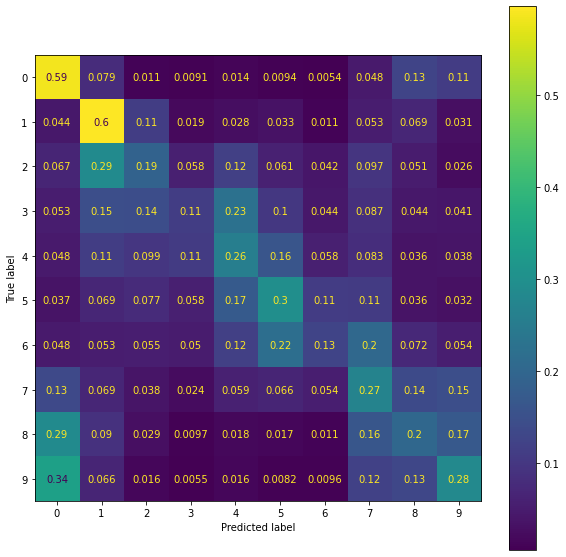

In [ ]:
fig = plt.figure(figsize=(10, 10))
disp = plot_confusion_matrix(clf, X2_test, y_test,
                                #  display_labels=class_names,
                                #  cmap=plt.cm.Blues)
                                normalize="true", ax=plt.gca())
plt.show()

# 下記は小川さんの成果

## データフレームの列の選択

`s` のうち `OL_Expenditure`までの列を選択し、細かい分類の支出情報の列を取り除いてみましょう。
そのためにはデータフレームの `loc` メソッドを使います。

In [ ]:
data = s.loc[:, :'OL_Expenditure']
data

,3City,T_SeJinin,T_SyuJinin,T_JuSyoyu,T_Syuhi,T_Age_5s,T_Age_65,Weight,Y_Income,L_Expenditure,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
0,1,2,1,1,1,1,1,895.266667,3917,201649,47756,16028,9652,6702,8088,726,21546,0,14433,76719
1,1,2,1,1,1,1,1,895.266667,6675,166381,34054,7416,26313,17062,6989,7637,20773,0,19048,27089
2,1,2,1,1,1,1,1,895.266667,6706,259736,84501,1927,10082,6741,5090,11015,53372,0,17289,69719
3,1,2,1,1,1,1,1,895.266667,2790,114511,41664,730,22358,5413,1205,5049,17411,0,8605,12077
4,1,2,1,1,1,1,1,895.266667,2577,193505,56981,3779,28747,4812,4243,751,16435,0,38231,39527
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45806,0,3,2,2,2,0,2,552.266667,4398,216774,46169,39809,32508,2896,4203,18778,21739,30,4315,46326
45807,0,3,2,2,2,0,2,552.266667,4844,165978,52670,37839,25403,3532,2293,7016,5022,8,12656,19540
45808,0,3,2,2,2,0,2,552.266667,4630,244064,53784,76871,18196,17747,3308,13499,27705,25,4309,28619
45809,0,3,2,2,2,0,2,552.266667,6738,399003,123080,38810,19711,2816,5666,21831,23914,28,58844,104302


## [記述統計量(英: descriptive statistics value)](https://ja.wikipedia.org/wiki/%E8%A6%81%E7%B4%84%E7%B5%B1%E8%A8%88%E9%87%8F) の確認

記述統計量を確認しデータの範囲や代表的な値がどの程度か確認しましょう。
そのためにはデータフレームの `describe` メソッドを使います。


In [ ]:
data.describe()

,3City,T_SeJinin,T_SyuJinin,T_JuSyoyu,T_Syuhi,T_Age_5s,T_Age_65,Weight,Y_Income,L_Expenditure,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
count,45811.000000,45811.00000,45811.000000,45811.000000,45811.000000,45811.000000,45811.000000,45811.000000,45811.000000,4.581100e+04,45811.000000,4.581100e+04,45811.000000,45811.000000,45811.000000,45811.000000,4.581100e+04,4.581100e+04,4.581100e+04,4.581100e+04
mean,0.400559,2.61291,1.489904,1.176966,1.250289,4.200214,1.291480,693.326887,6401.920652,2.983737e+05,68740.210364,1.612791e+04,19420.995569,9373.956342,12054.818668,13280.968850,4.469237e+04,1.501489e+04,3.109929e+04,6.856828e+04
std,0.490017,0.48709,0.499904,0.381644,0.433184,3.137751,0.454449,161.527843,3810.787269,1.649328e+05,29209.813101,3.878798e+04,8246.369457,12941.144209,15069.659817,18928.182013,7.738839e+04,4.417047e+04,3.289503e+04,8.456648e+04
min,0.000000,2.00000,1.000000,1.000000,1.000000,0.000000,1.000000,510.050847,366.000000,4.208400e+04,9737.000000,0.000000e+00,1632.000000,27.000000,64.000000,45.000000,7.800000e+01,0.000000e+00,3.720000e+02,3.450000e+02
25%,0.000000,2.00000,1.000000,1.000000,1.000000,0.000000,1.000000,566.503597,3805.000000,1.942165e+05,48104.500000,6.590000e+02,13589.500000,2877.500000,3893.500000,3849.000000,1.037250e+04,0.000000e+00,1.218200e+04,2.479300e+04
50%,0.000000,3.00000,1.000000,1.000000,1.000000,4.000000,1.000000,594.246377,5504.000000,2.602560e+05,63498.000000,2.877000e+03,17905.000000,5614.000000,7686.000000,7687.000000,2.346500e+04,1.761000e+03,2.170800e+04,4.463400e+04
75%,1.000000,3.00000,2.000000,1.000000,2.000000,7.000000,2.000000,811.616592,7983.500000,3.549910e+05,83502.000000,1.746200e+04,23544.500000,11058.000000,14515.500000,15434.500000,4.876050e+04,1.353500e+04,3.831100e+04,8.090950e+04
max,1.000000,3.00000,2.000000,2.000000,2.000000,9.000000,2.000000,1365.894737,67394.000000,3.161852e+06,394347.000000,1.702352e+06,128725.000000,584980.000000,569141.000000,715039.000000,2.306300e+06,2.711758e+06,1.019545e+06,2.133987e+06


## plotly (express) を用いた可視化

ここでは家計調査の中項目を可視化してみましょう。    
まずはバイオリンプロットで全ての項目を可視化します。    
PlotlyExpressとデータフレームを使ってグラフを描画する場合、作成したいグラフの種類の関数に、まずデータフレームを持っている変数名を渡し、そのあと表示したい要素を引数に渡します。    
最初の事例では data の全てのコラムをバイオリンで可視化しました。(かなり表示に時間がかかります)





In [ ]:
import plotly.express as px

In [ ]:
px.violin(data, y=data.columns)

## ヒストグラムの作成
続いて Y_Income (収入)のヒストグラムを作成します。     
引数nbins には、ヒストグラムのビンの数を指定 、引数histnormにはパーセントを指定すると、y軸が%表記となります。

In [ ]:
px.histogram(data, x='Y_Income', histnorm='percent', nbins=100)

## ビンを作る
自動でビンを作るほか、自作することもできます。    
pandasのcut関数を使うと、引数binsに指定した数のビンを作成してくれます。     
しかし、この方法は次に見るように、データのテールが長いと使い勝手の悪いビン分けとなります。

In [ ]:
data_bins = pd.cut(data['Y_Income'].values, bins=10)
data_bins

[(298.972, 7068.8], (298.972, 7068.8], (298.972, 7068.8], (298.972, 7068.8], (298.972, 7068.8], ..., (298.972, 7068.8], (298.972, 7068.8], (298.972, 7068.8], (298.972, 7068.8], (298.972, 7068.8]]
Length: 45811
Categories (10, interval[float64]): [(298.972, 7068.8] < (7068.8, 13771.6] < (13771.6, 20474.4] <
                                     (20474.4, 27177.2] ... (40582.8, 47285.6] < (47285.6, 53988.4] <
                                     (53988.4, 60691.2] < (60691.2, 67394.0]]

## 自分で作成したビンを割り当てる
numpyのdigitize関数を使うと、自分の指定するビンを作成することができます    
引数x（第1引数）にはビン分けしたい値を、引数bins（第2引数）にビン分けの定義をわたします      
返り値はどのビンに入っているかを数値となります


In [ ]:
import numpy as np 
bin_image = [0, 2000, 4000, 6000, 8000, 12000, 20000]
bin_array = np.digitize(data['Y_Income'], bin_image)

### ビンの割り当て
全てのデータがどのビンに入っているか、割り当てられる

In [ ]:
len(bin_array)

45811

In [ ]:
pd.Series(bin_array).unique()

array([2, 4, 5, 3, 6, 7, 1])

In [ ]:
help(np.digitize)

Help on function digitize in module numpy:

digitize(x, bins, right=False)
    Return the indices of the bins to which each value in input array belongs.
    
    =========  =============  ============================
    `right`    order of bins  returned index `i` satisfies
    =========  =============  ============================
    ``False``  increasing     ``bins[i-1] <= x < bins[i]``
    ``True``   increasing     ``bins[i-1] < x <= bins[i]``
    ``False``  decreasing     ``bins[i-1] > x >= bins[i]``
    ``True``   decreasing     ``bins[i-1] >= x > bins[i]``
    =========  =============  ============================
    
    If values in `x` are beyond the bounds of `bins`, 0 or ``len(bins)`` is
    returned as appropriate.
    
    Parameters
    ----------
    x : array_like
        Input array to be binned. Prior to NumPy 1.10.0, this array had to
        be 1-dimensional, but can now have any shape.
    bins : array_like
        Array of bins. It has to be 1-dimensional and 

## データの列名と項目の確認
データの詳細が書かれたエクセルファイルを読み込み、確認します

In [ ]:
cont = pd.read_excel("/content/ippan_2009zensho_s/ippan_2009zensho_s.xls")

In [ ]:
cont[:50]

,政府統計コード,00200564,実施時期,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,作成日,2017-06-09 00:00:00,訂正日
0,統計調査名,平成21年全国消費実態調査,集計区分,NaN,NaN,全世帯（二人以上の世帯）,NaN,ファイル名,NaN,NaN
1,調査票名,一般用ミクロデータ（詳細品目）,(備考・補足事項),NaN,NaN,NaN,NaN,NaN,(照会先等),NaN
2,コード体系,Shift_JIS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,項目総数,430,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,文字列引用符,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,行番号,項目名,階層,項目番号,型,種別,変数名,符号,符号内容,備考
7,1,３大都市圏か否か,1,1,,,3City,1,３大都市圏,NaN
8,2,NaN,NaN,NaN,NaN,NaN,NaN,0,３大都市圏以外,NaN
9,3,世帯人員,1,2,,,T_SeJinin,2,２人,NaN


## 各消費分類の消費支出に対する割合を作成する
各消費分類が全体に占める割合をみるため、そのデータを作成します    
上で確認したようにL_Expenditureが消費額となり、それで全項目を割ると欲しい値が算出できる     
具体的にはapplyメソッドとlambda式を用いて行全体をL_Expenditureで割ります

In [ ]:
data_test = data.loc[: ,'L_Expenditure':'OL_Expenditure']

In [ ]:
data_test

,L_Expenditure,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
0,201649,47756,16028,9652,6702,8088,726,21546,0,14433,76719
1,166381,34054,7416,26313,17062,6989,7637,20773,0,19048,27089
2,259736,84501,1927,10082,6741,5090,11015,53372,0,17289,69719
3,114511,41664,730,22358,5413,1205,5049,17411,0,8605,12077
4,193505,56981,3779,28747,4812,4243,751,16435,0,38231,39527
...,...,...,...,...,...,...,...,...,...,...,...
45806,216774,46169,39809,32508,2896,4203,18778,21739,30,4315,46326
45807,165978,52670,37839,25403,3532,2293,7016,5022,8,12656,19540
45808,244064,53784,76871,18196,17747,3308,13499,27705,25,4309,28619
45809,399003,123080,38810,19711,2816,5666,21831,23914,28,58844,104302


In [ ]:
data_test.apply(lambda x: x/ data_test['L_Expenditure'])

,L_Expenditure,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
0,1.0,0.236827,0.079485,0.047865,0.033236,0.040109,0.003600,0.106849,0.000000,0.071575,0.380458
1,1.0,0.204675,0.044572,0.158149,0.102548,0.042006,0.045901,0.124852,0.000000,0.114484,0.162813
2,1.0,0.325334,0.007419,0.038816,0.025953,0.019597,0.042408,0.205486,0.000000,0.066564,0.268423
3,1.0,0.363843,0.006375,0.195248,0.047271,0.010523,0.044092,0.152047,0.000000,0.075146,0.105466
4,1.0,0.294468,0.019529,0.148559,0.024868,0.021927,0.003881,0.084933,0.000000,0.197571,0.204269
...,...,...,...,...,...,...,...,...,...,...,...
45806,1.0,0.212982,0.183643,0.149963,0.013360,0.019389,0.086625,0.100284,0.000138,0.019906,0.213706
45807,1.0,0.317331,0.227976,0.153050,0.021280,0.013815,0.042271,0.030257,0.000048,0.076251,0.117726
45808,1.0,0.220368,0.314962,0.074554,0.072715,0.013554,0.055309,0.113515,0.000102,0.017655,0.117260
45809,1.0,0.308469,0.097267,0.049401,0.007058,0.014200,0.054714,0.059934,0.000070,0.147478,0.261407


In [ ]:
data_expenditure_ratio = data_test.apply(lambda x: x / data_test['L_Expenditure'])


## 作成した割合を可視化
再びバイオリンプロットで可視化します     
かなりテールが長いものとなっていることが分かります



In [ ]:
px.violin(data_expenditure_ratio, x=data_expenditure_ratio.columns[1:])

## 分析に使うデータを作成します
- まず、data の基礎情報の部分と先ほど作成した消費の割合のデータをpandasのconcat関数を用いて連結します
- 次に年収のビン分けデータを先ほどのデータに加えます

In [ ]:
data_front = data.loc[:, :'Y_Income']
data_front = data_front.drop('Weight',axis=1)
data_preped = pd.concat([data_front, data_expenditure_ratio], axis=1)

In [ ]:
data_preped

,3City,T_SeJinin,T_SyuJinin,T_JuSyoyu,T_Syuhi,T_Age_5s,T_Age_65,Y_Income,L_Expenditure,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure
0,1,2,1,1,1,1,1,3917,1.0,0.236827,0.079485,0.047865,0.033236,0.040109,0.003600,0.106849,0.000000,0.071575,0.380458
1,1,2,1,1,1,1,1,6675,1.0,0.204675,0.044572,0.158149,0.102548,0.042006,0.045901,0.124852,0.000000,0.114484,0.162813
2,1,2,1,1,1,1,1,6706,1.0,0.325334,0.007419,0.038816,0.025953,0.019597,0.042408,0.205486,0.000000,0.066564,0.268423
3,1,2,1,1,1,1,1,2790,1.0,0.363843,0.006375,0.195248,0.047271,0.010523,0.044092,0.152047,0.000000,0.075146,0.105466
4,1,2,1,1,1,1,1,2577,1.0,0.294468,0.019529,0.148559,0.024868,0.021927,0.003881,0.084933,0.000000,0.197571,0.204269
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45806,0,3,2,2,2,0,2,4398,1.0,0.212982,0.183643,0.149963,0.013360,0.019389,0.086625,0.100284,0.000138,0.019906,0.213706
45807,0,3,2,2,2,0,2,4844,1.0,0.317331,0.227976,0.153050,0.021280,0.013815,0.042271,0.030257,0.000048,0.076251,0.117726
45808,0,3,2,2,2,0,2,4630,1.0,0.220368,0.314962,0.074554,0.072715,0.013554,0.055309,0.113515,0.000102,0.017655,0.117260
45809,0,3,2,2,2,0,2,6738,1.0,0.308469,0.097267,0.049401,0.007058,0.014200,0.054714,0.059934,0.000070,0.147478,0.261407


In [ ]:
bin_image = [0, 2000, 4000, 6000, 8000, 12000, 20000]
bin_array = np.digitize(data['Y_Income'], bin_image)
data_preped['bins'] = bin_array

In [ ]:
data_preped

,3City,T_SeJinin,T_SyuJinin,T_JuSyoyu,T_Syuhi,T_Age_5s,T_Age_65,Y_Income,L_Expenditure,Food,Housing,LFW,Furniture,Clothes,Health,Transport,Education,Recreation,OL_Expenditure,bins
0,1,2,1,1,1,1,1,3917,1.0,0.236827,0.079485,0.047865,0.033236,0.040109,0.003600,0.106849,0.000000,0.071575,0.380458,2
1,1,2,1,1,1,1,1,6675,1.0,0.204675,0.044572,0.158149,0.102548,0.042006,0.045901,0.124852,0.000000,0.114484,0.162813,4
2,1,2,1,1,1,1,1,6706,1.0,0.325334,0.007419,0.038816,0.025953,0.019597,0.042408,0.205486,0.000000,0.066564,0.268423,4
3,1,2,1,1,1,1,1,2790,1.0,0.363843,0.006375,0.195248,0.047271,0.010523,0.044092,0.152047,0.000000,0.075146,0.105466,2
4,1,2,1,1,1,1,1,2577,1.0,0.294468,0.019529,0.148559,0.024868,0.021927,0.003881,0.084933,0.000000,0.197571,0.204269,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45806,0,3,2,2,2,0,2,4398,1.0,0.212982,0.183643,0.149963,0.013360,0.019389,0.086625,0.100284,0.000138,0.019906,0.213706,3
45807,0,3,2,2,2,0,2,4844,1.0,0.317331,0.227976,0.153050,0.021280,0.013815,0.042271,0.030257,0.000048,0.076251,0.117726,3
45808,0,3,2,2,2,0,2,4630,1.0,0.220368,0.314962,0.074554,0.072715,0.013554,0.055309,0.113515,0.000102,0.017655,0.117260,3
45809,0,3,2,2,2,0,2,6738,1.0,0.308469,0.097267,0.049401,0.007058,0.014200,0.054714,0.059934,0.000070,0.147478,0.261407,4


# ビンごとに可視化
ビンごとにデータを可視化します    
この場合、PlotlyExpressではなく、plotly graph_objectsを使って可視化しています     
少し複雑な可視化はPlotlyExpressでは表現しきれなくなります    
そのような場合、Plotly Graph Objectsを使います


In [ ]:
import plotly.graph_objects as go

In [ ]:
fig = go.Figure()

for num in data_preped.bins.unique():
  data_preped_num = data_preped[data_preped['bins'] == num]
  fig.add_trace(go.Histogram(x=data_preped_num['Food'], name=f'{num}', histnorm='probability', nbinsx=20))

fig.show()

## Dashを用いてインタラクティブな可視化！

- ビンの個数を動かせる
- ビンの数値を変更できる
- それをヒストグラムで描画できる

In [ ]:
data_for_dash = data_preped.drop('bins', axis=1)

In [ ]:
from jupyter_dash import JupyterDash 
import dash_core_components as dcc 
import dash_html_components as html 

from dash.dependencies import Input, Output, State, ALL

In [ ]:
external_stylesheets = ['https://codepen.io/chriddyp/pen/bWLwgP.css']

app = JupyterDash(__name__, external_stylesheets=external_stylesheets)

app.layout = html.Div([
                       

                       html.Button(id='my_button', children='Add Input'),
                      
                      html.Div([
                       html.Div([
                       html.Div(id='input_zone', children=[]),
                      ], style={'width': '25%', 'display': 'inline-block', 'verticalAlign': 'top'}),
                       


                       html.Div([
                                 dcc.Dropdown(id='my_dropdown',
                                              options=[{'label': col, 'value': col} for col in data_for_dash.columns],
                                              value='Food'
                                              ),
                                 dcc.Graph(id='my_graph'),
                                
                                html.Div([
                                 html.H3('Histogram Bin Num: '),
                                 dcc.Input(id='bin_num', value=10, type='number'),
                                ]),
                       ], style={'width': '70%', 'display': 'inline-block'}),
                      ]),
                       
                       html.Div([
                       dcc.RangeSlider(id='my_range_slider',
                                       min=0,
                                       max=data_for_dash['Y_Income'].max()
                                       
                                       ),
                        html.Button(id='slider_button', children='graph update'),
                       ], style={'width': '90%', 'height': 100, 'margin': 'auto'}),

])

@app.callback(Output('input_zone', 'children'), [Input('my_button', 'n_clicks')], [State('input_zone', 'children')], prevent_initial_call=True)
def update_input_zone(n_clicks, existing_children):
  my_inputs = html.Div([
                        dcc.Input(id={'type': 'my_inputs', 'index': n_clicks}, value=0)
  ])
  existing_children.append(my_inputs)
  return existing_children

@app.callback(Output('my_range_slider', 'value'), [Input({'type': 'my_inputs', 'index': ALL}, 'value')])
def update_slider(enter_values):
  if len(enter_values) > 1:
    enter_values = [int(i) for i in enter_values]
  return enter_values

@app.callback(Output('my_graph', 'figure'), [Input('slider_button', 'n_clicks'), Input('my_dropdown', 'value'), Input('bin_num', 'value')], [State('my_range_slider','value')], prevent_initial_call=True)
def update_graph(n_clicks, slider_values, bin_num, selected_values):

  if len(selected_values) > 1 and sum(selected_values) > 1:
    bin_array = np.digitize(data_for_dash['Y_Income'], selected_values)
    data_for_dash['bins'] = bin_array  
    fig = go.Figure()
    for num in data_for_dash['bins'].unique():
      update_df = data_for_dash[data_for_dash['bins'] == num]
      fig.add_trace(go.Histogram(x=update_df[slider_values], histnorm='probability', nbinsx=bin_num))
  
    return fig
  return dash.no_update


app.run_server(mode='inline')

<IPython.core.display.Javascript object>